In [3]:
import json
from colormath.color_objects import AdobeRGBColor
from src.color_ga import ColorGeneticAlgorithm
import matplotlib.pyplot as plt
import numpy as np

20
Generation 0:

Ind 0: 	   		C0:   	 100.0%	C1:   	 0.0%	C2:   	 0.0%	
Ind 1: 	   		C0:   	 0.0%	C1:   	 100.0%	C2:   	 0.0%	
Ind 2: 	   		C0:   	 0.0%	C1:   	 0.0%	C2:   	 100.0%	

Starting the algorithm...


Generation 1:
IND1: 	   		C0:   	 100.0%	C1:   	 0.0%	C2:   	 0.0%	 DIST:0.0
IND4: 	   		C0:   	 100.0%	C1:   	 0.0%	C2:   	 0.0%	 DIST:0.0
IND3: 	   		C0:   	 50.0%	C1:   	 50.0%	C2:   	 0.0%	 DIST:104.17
IND6: 	   		C0:   	 0.0%	C1:   	 40.0%	C2:   	 60.0%	 DIST:178.79
IND2: 	   		C0:   	 0.0%	C1:   	 0.0%	C2:   	 100.0%	 DIST:195.62
IND5: 	   		C0:   	 0.0%	C1:   	 0.0%	C2:   	 100.0%	 DIST:195.62
IND0: 	   		C0:   	 0.0%	C1:   	 100.0%	C2:   	 0.0%	 DIST:220.62
20
Generation 0:

Ind 0: 	   		C0:   	 100.0%	C1:   	 0.0%	C2:   	 0.0%	
Ind 1: 	   		C0:   	 0.0%	C1:   	 100.0%	C2:   	 0.0%	
Ind 2: 	   		C0:   	 0.0%	C1:   	 0.0%	C2:   	 100.0%	

Starting the algorithm...


Generation 1:
IND1: 	   		C0:   	 100.0%	C1:   	 0.0%	C2:   	 0.0%	 DIST:0.0
IND3: 	   		C0:   	 50.0%	C1:

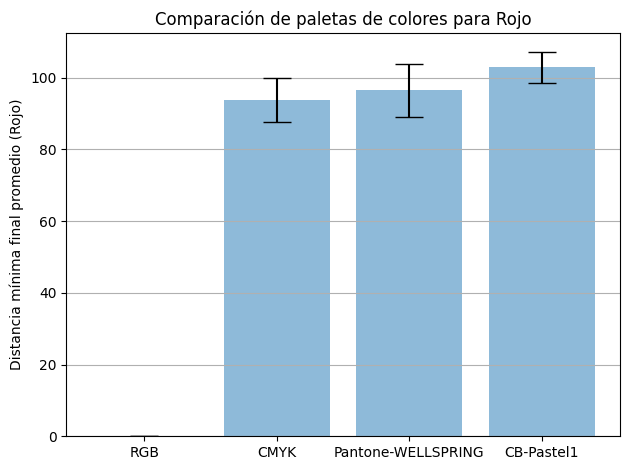

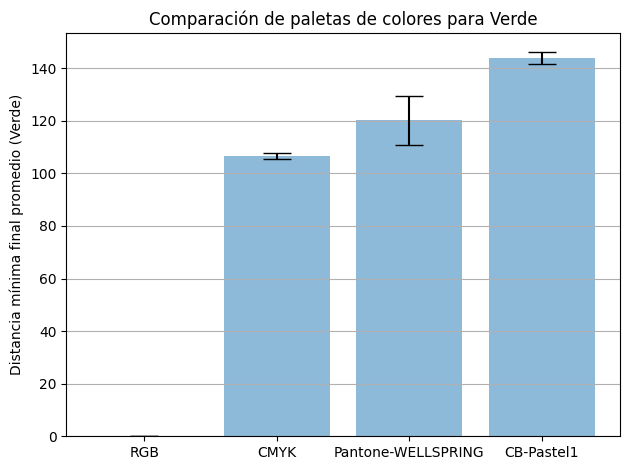

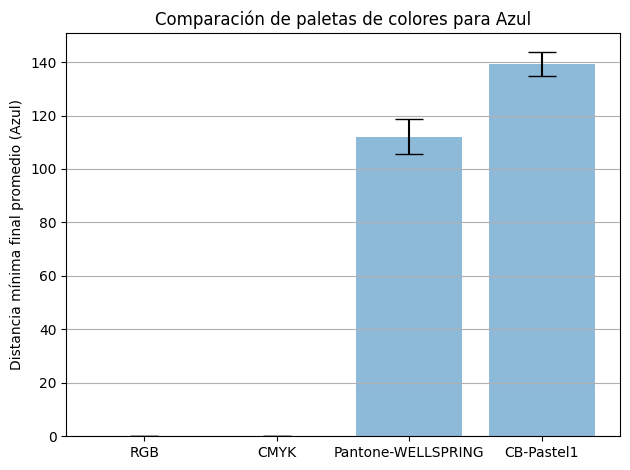

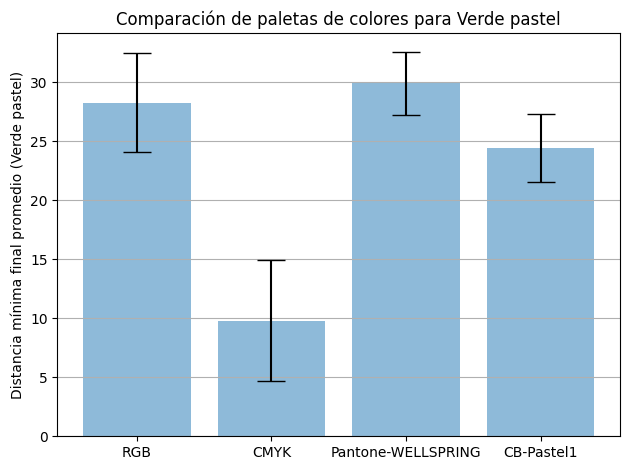

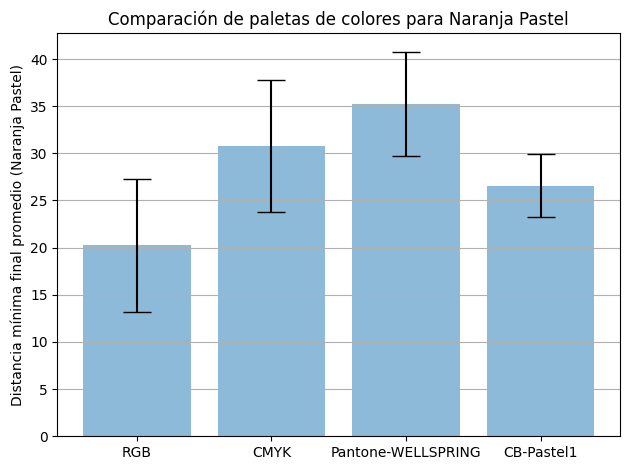

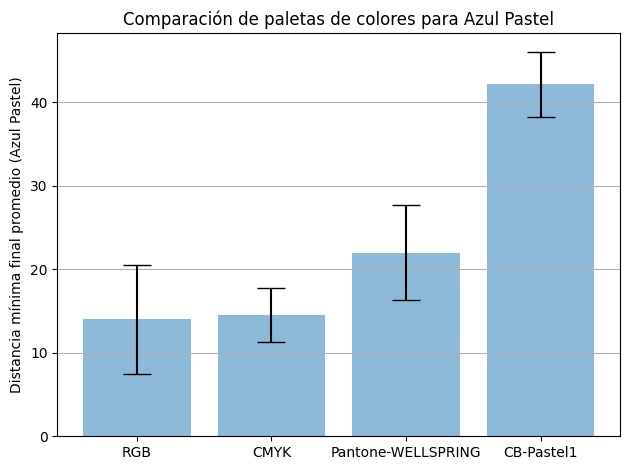

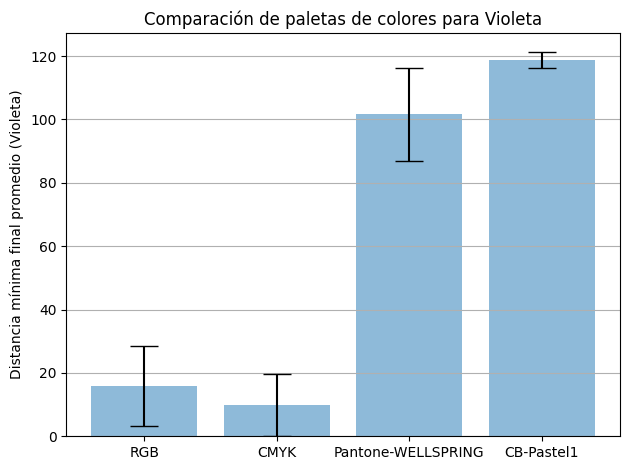

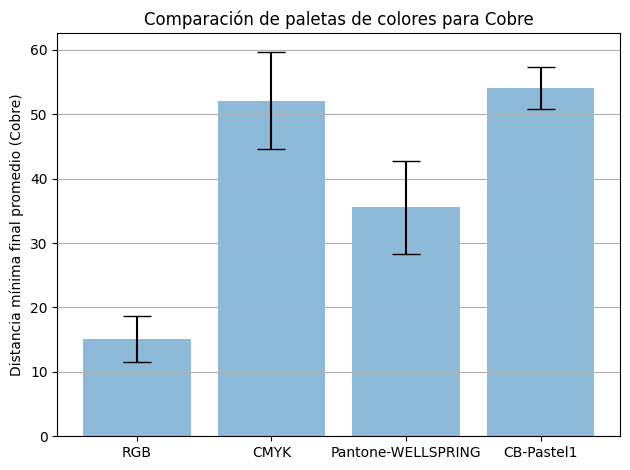

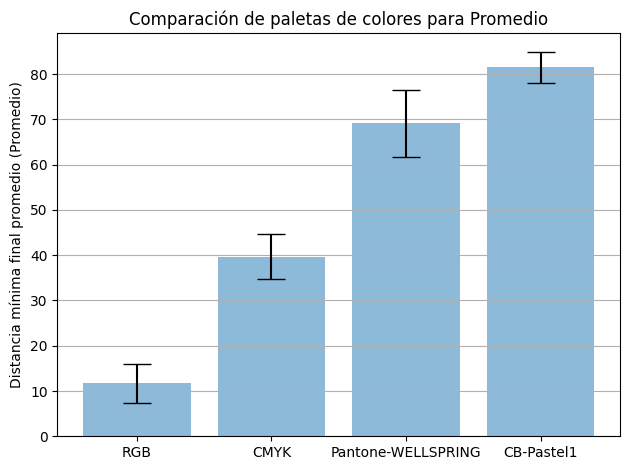

In [4]:
# Load configuration
with open("config.json", "r") as f:
    config = json.load(f)

config_parameters = {k: config[k] for k in [
    "population", "selection_method", "crossover_method",
    "mutation_method", "finish_method", "finish_parameters",
    "palettes", "targets"
]}


# Functions
def create_color_objects(palette):
    return [AdobeRGBColor(r, g, b, True) for r, g, b in palette]


def perform_ga_runs(palette_colors, target):
    min_distances_all_runs = []
    for _ in range(10):
        ga = ColorGeneticAlgorithm(palette_colors, target, config_parameters)
        results = ga.start()
        history = results['history']
        last_generation = history[-1]
        min_distance = min(individual['distance'] for individual in last_generation)
        min_distances_all_runs.append(min_distance)
    return min_distances_all_runs


def plot_target(target_name, target_indices, all_palettes_min_distances):
    fig, ax = plt.subplots()
    palette_names, means, std_devs = [], [], []

    for palette_name, min_distances_all_runs in all_palettes_min_distances.items():
        palette_names.append(palette_name)

        if isinstance(target_indices, slice):
            means_for_targets = [np.mean(min_distances_all_runs[t_index]) for t_index in range(len(targets))]
            std_devs_for_targets = [np.std(min_distances_all_runs[t_index]) for t_index in range(len(targets))]
            means.append(np.mean(means_for_targets))
            std_devs.append(np.mean(std_devs_for_targets))
        else:
            means.append(np.mean(min_distances_all_runs[target_indices]))
            std_devs.append(np.std(min_distances_all_runs[target_indices]))

    x_pos = np.arange(len(palette_names))
    ax.bar(x_pos, means, yerr=std_devs, align='center', alpha=0.5, ecolor='black', capsize=10)
    ax.set_ylabel(f'Distancia mínima final promedio ({target_name})')
    ax.set_xticks(x_pos)
    ax.set_xticklabels(palette_names)
    ax.set_title(f'Comparación de paletas de colores para {target_name}')
    ax.yaxis.grid(True)

    plt.tight_layout()
    plt.show()



# Main script
targets = [AdobeRGBColor(*target["color"], True) for target in config_parameters["targets"]]
palettes = [(palette["name"], create_color_objects(palette["colors"])) for palette in config_parameters["palettes"]]

all_palettes_min_distances = {
    palette_name: np.array([perform_ga_runs(palette_colors, target) for target in targets], dtype=object)
    for palette_name, palette_colors in palettes
}

for target_index, target in enumerate(targets):
    target_name = config_parameters["targets"][target_index]["name"]
    plot_target(target_name, target_index, all_palettes_min_distances)

plot_target("Promedio", slice(None), all_palettes_min_distances)